In [3]:
import json
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pycocotools import mask as coco_mask

In [2]:
pip install pycocotools

Note: you may need to restart the kernel to use updated packages.


In [5]:
with open('_annotations.coco.json') as f:
    coco_data=json.load(f)
coco_data

{'info': {'year': '2025',
  'version': '1',
  'description': 'Exported from roboflow.com',
  'contributor': '',
  'url': 'https://public.roboflow.com/object-detection/undefined',
  'date_created': '2025-12-25T12:07:17+00:00'},
 'licenses': [{'id': 1,
   'url': 'https://creativecommons.org/licenses/by/4.0/',
   'name': 'CC BY 4.0'}],
 'categories': [{'id': 0, 'name': 'objects', 'supercategory': 'none'},
  {'id': 1, 'name': 'all', 'supercategory': 'objects'},
  {'id': 2, 'name': 'cat_dog', 'supercategory': 'objects'},
  {'id': 3, 'name': 'cats', 'supercategory': 'objects'},
  {'id': 4, 'name': 'chem', 'supercategory': 'objects'},
  {'id': 5, 'name': 'dog', 'supercategory': 'objects'},
  {'id': 6, 'name': 'donkey', 'supercategory': 'objects'},
  {'id': 7, 'name': 'giraffee', 'supercategory': 'objects'},
  {'id': 8, 'name': 'horse', 'supercategory': 'objects'},
  {'id': 9, 'name': 'monkey', 'supercategory': 'objects'},
  {'id': 10, 'name': 'mouse', 'supercategory': 'objects'},
  {'id': 11,

In [13]:
img_info=coco_data['images'][0]
img_info

{'id': 0,
 'license': 1,
 'file_name': '400000186_jpeg.rf.430ee6d3c8b4a243c0aeac30401131e1.jpg',
 'height': 312,
 'width': 312,
 'date_captured': '2025-12-25T12:07:17+00:00',
 'extra': {'name': '400000186.jpeg'}}

In [14]:
img_path=f"{img_info['file_name']}"
img_path

'400000186_jpeg.rf.430ee6d3c8b4a243c0aeac30401131e1.jpg'

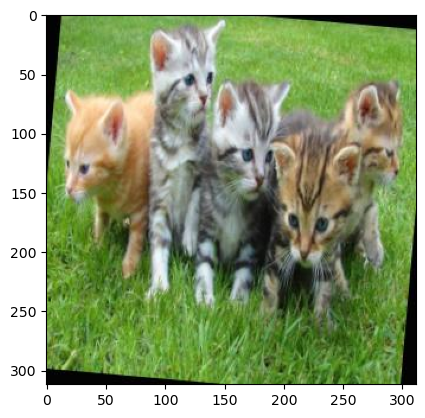

In [16]:
img=cv2.imread(img_path)
img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
plt.imshow(img)

In [17]:
coco_data["annotations"]

[{'id': 1,
  'image_id': 0,
  'category_id': 3,
  'bbox': [16, 5, 284.18, 252.921],
  'area': 71874.948,
  'segmentation': [[29.144,
    156.154,
    34.975,
    149.163,
    41.902,
    153.519,
    43.241,
    162.076,
    41.805,
    184.455,
    43.633,
    187.428,
    47.748,
    182.162,
    48.236,
    176.578,
    54.586,
    169.632,
    59.574,
    166.318,
    63.311,
    171.333,
    69.172,
    169.971,
    71.059,
    184.201,
    65.316,
    208.079,
    66.33,
    220.358,
    68.92,
    220.584,
    76.631,
    210.007,
    83.654,
    183.428,
    86.955,
    187.467,
    89.226,
    209.233,
    86.947,
    235.289,
    91.69,
    234.767,
    94.687,
    230.34,
    101.34,
    231.86,
    103.22,
    228.274,
    126.146,
    222.778,
    125.961,
    236.827,
    128.063,
    242.637,
    189.9,
    251.798,
    195.213,
    244.761,
    195.428,
    236.341,
    202.044,
    214.415,
    206.595,
    210.125,
    213.411,
    209.783,
    224.482,
    214.503,
 

In [18]:
annotaions=[ann for ann in coco_data['annotations'] if ann['image_id']==img_info['id']]
annotaions

[{'id': 1,
  'image_id': 0,
  'category_id': 3,
  'bbox': [16, 5, 284.18, 252.921],
  'area': 71874.948,
  'segmentation': [[29.144,
    156.154,
    34.975,
    149.163,
    41.902,
    153.519,
    43.241,
    162.076,
    41.805,
    184.455,
    43.633,
    187.428,
    47.748,
    182.162,
    48.236,
    176.578,
    54.586,
    169.632,
    59.574,
    166.318,
    63.311,
    171.333,
    69.172,
    169.971,
    71.059,
    184.201,
    65.316,
    208.079,
    66.33,
    220.358,
    68.92,
    220.584,
    76.631,
    210.007,
    83.654,
    183.428,
    86.955,
    187.467,
    89.226,
    209.233,
    86.947,
    235.289,
    91.69,
    234.767,
    94.687,
    230.34,
    101.34,
    231.86,
    103.22,
    228.274,
    126.146,
    222.778,
    125.961,
    236.827,
    128.063,
    242.637,
    189.9,
    251.798,
    195.213,
    244.761,
    195.428,
    236.341,
    202.044,
    214.415,
    206.595,
    210.125,
    213.411,
    209.783,
    224.482,
    214.503,
 

In [28]:
img_info

{'id': 0,
 'license': 1,
 'file_name': '400000186_jpeg.rf.430ee6d3c8b4a243c0aeac30401131e1.jpg',
 'height': 312,
 'width': 312,
 'date_captured': '2025-12-25T12:07:17+00:00',
 'extra': {'name': '400000186.jpeg'}}

In [33]:
segmentation= [[29.144,
    156.154,
    34.975,
    149.163,
    41.902,
    153.519,
    43.241,
    162.076,
    41.805,
    184.455,
    43.633,
    187.428,
    47.748,
    182.162,
    48.236,
    176.578,
    54.586,
    169.632,
    59.574,
    166.318,
    63.311,
    171.333,
    69.172,
    169.971,
    71.059,
    184.201,
    65.316,
    208.079,
    66.33,
    220.358,
    68.92,
    220.584,
    76.631,
    210.007,
    83.654,
    183.428,
    86.955,
    187.467,
    89.226,
    209.233,
    86.947,
    235.289,
    91.69,
    234.767,
    94.687,
    230.34,
    101.34,
    231.86,
    103.22,
    228.274,
    126.146,
    222.778,
    125.961,
    236.827,
    128.063,
    242.637,
    189.9,
    251.798,
    195.213,
    244.761,
    195.428,
    236.341,
    202.044,
    214.415,
    206.595,
    210.125,
    213.411,
    209.783,
    224.482,
    214.503,
    227.812,
    224.171,
    226.213,
    248.411,
    228.507,
    257.989,
    232.133,
    258.306,
    237.417,
    245.641,
    244.352,
    202.175,
    250.672,
    189.601,
    257.895,
    184.606,
    265.583,
    186.217,
    272.081,
    207.415,
    282.278,
    210.182,
    283.529,
    201.852,
    282.19,
    193.296,
    278.453,
    188.28,
    278.86,
    183.627,
    275.041,
    179.543,
    277.735,
    166.65,
    274.597,
    160.75,
    286.964,
    132.763,
    290.153,
    132.104,
    292.773,
    137.96,
    296.614,
    129.856,
    295.437,
    119.439,
    298.649,
    106.592,
    299.841,
    87.005,
    295.112,
    57.522,
    290.968,
    57.16,
    286.254,
    63.311,
    281.318,
    60.066,
    269.759,
    60.93,
    264.882,
    68.943,
    260.738,
    68.58,
    260.412,
    72.303,
    256.431,
    70.079,
    249.186,
    87.261,
    245.397,
    88.805,
    150.052,
    9.198,
    149.342,
    5.385,
    137.212,
    12.764,
    118.208,
    9.226,
    105.643,
    15.628,
    92.174,
    14.449,
    89.177,
    18.876,
    88.281,
    29.112,
    90.338,
    59.298,
    81.236,
    67.879,
    74.339,
    69.151,
    71.452,
    78.276,
    66.191,
    78.753,
    60.026,
    71.65,
    38.706,
    70.722,
    29.493,
    74.605,
    21.856,
    66.435,
    17.63,
    67.003,
    16.624,
    72.541,
    21.508,
    82.345,
    17.533,
    97.938,
    15.661,
    119.342,
    17.245,
    125.106,
    16.845,
    147.576,
    23.882,
    156.631,
    29.144,
    156.154]]

 here segemations are in x and y corrdinated

In [37]:
for seg in segmentation:
    # print(len(seg))
    print(np.array(seg).reshape((len(seg)//2,2)))

194
[[ 29.144 156.154]
 [ 34.975 149.163]
 [ 41.902 153.519]
 [ 43.241 162.076]
 [ 41.805 184.455]
 [ 43.633 187.428]
 [ 47.748 182.162]
 [ 48.236 176.578]
 [ 54.586 169.632]
 [ 59.574 166.318]
 [ 63.311 171.333]
 [ 69.172 169.971]
 [ 71.059 184.201]
 [ 65.316 208.079]
 [ 66.33  220.358]
 [ 68.92  220.584]
 [ 76.631 210.007]
 [ 83.654 183.428]
 [ 86.955 187.467]
 [ 89.226 209.233]
 [ 86.947 235.289]
 [ 91.69  234.767]
 [ 94.687 230.34 ]
 [101.34  231.86 ]
 [103.22  228.274]
 [126.146 222.778]
 [125.961 236.827]
 [128.063 242.637]
 [189.9   251.798]
 [195.213 244.761]
 [195.428 236.341]
 [202.044 214.415]
 [206.595 210.125]
 [213.411 209.783]
 [224.482 214.503]
 [227.812 224.171]
 [226.213 248.411]
 [228.507 257.989]
 [232.133 258.306]
 [237.417 245.641]
 [244.352 202.175]
 [250.672 189.601]
 [257.895 184.606]
 [265.583 186.217]
 [272.081 207.415]
 [282.278 210.182]
 [283.529 201.852]
 [282.19  193.296]
 [278.453 188.28 ]
 [278.86  183.627]
 [275.041 179.543]
 [277.735 166.65 ]
 [274.59

In [29]:
mask = np.zeros((img_info["height"], img_info["width"]), dtype=np.uint8)
mask

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

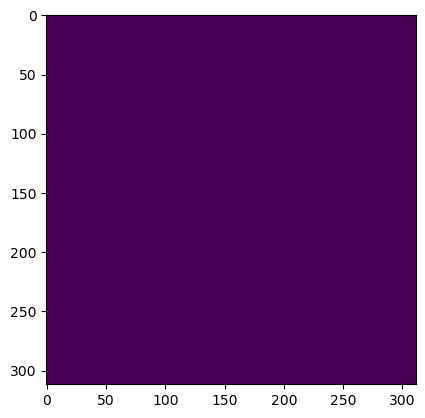

In [30]:
plt.imshow(mask)

In [31]:
annotaions

[{'id': 1,
  'image_id': 0,
  'category_id': 3,
  'bbox': [16, 5, 284.18, 252.921],
  'area': 71874.948,
  'segmentation': [[29.144,
    156.154,
    34.975,
    149.163,
    41.902,
    153.519,
    43.241,
    162.076,
    41.805,
    184.455,
    43.633,
    187.428,
    47.748,
    182.162,
    48.236,
    176.578,
    54.586,
    169.632,
    59.574,
    166.318,
    63.311,
    171.333,
    69.172,
    169.971,
    71.059,
    184.201,
    65.316,
    208.079,
    66.33,
    220.358,
    68.92,
    220.584,
    76.631,
    210.007,
    83.654,
    183.428,
    86.955,
    187.467,
    89.226,
    209.233,
    86.947,
    235.289,
    91.69,
    234.767,
    94.687,
    230.34,
    101.34,
    231.86,
    103.22,
    228.274,
    126.146,
    222.778,
    125.961,
    236.827,
    128.063,
    242.637,
    189.9,
    251.798,
    195.213,
    244.761,
    195.428,
    236.341,
    202.044,
    214.415,
    206.595,
    210.125,
    213.411,
    209.783,
    224.482,
    214.503,
 

In [39]:
def create_binary_mask(segmentations,image_height,image_width):
    mask= np.zeros((image_height,image_width), dtype=np.uint8)
    for seg in segmentation:
        poly=(np.array(seg).reshape((len(seg)//2,2)))
        cv2.fillPoly(mask,[np.int32(poly)],1)
    return mask

for ann in annotaions:
    binary_mask=create_binary_mask(ann["segmentation"],img_info["height"], img_info["width"])
    mask=np.maximum(mask,binary_mask)

Text(0.5, 1.0, 'masked')

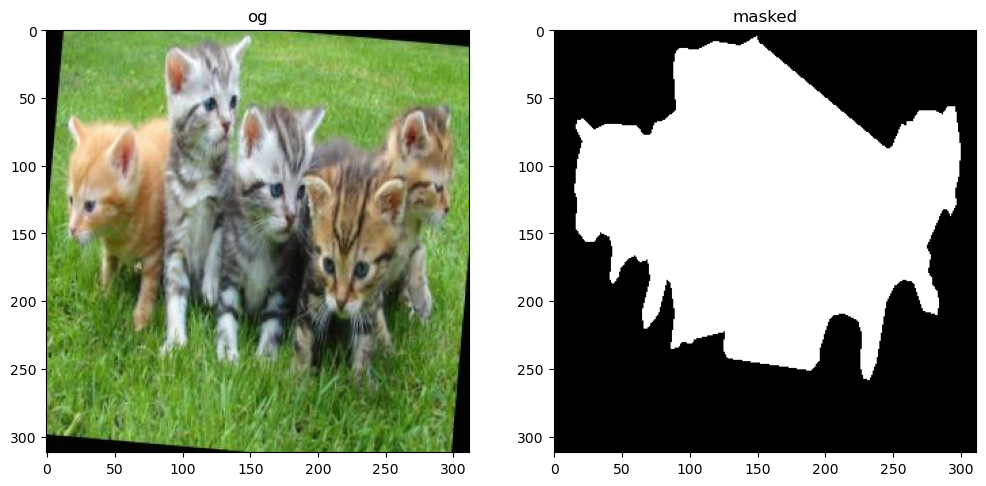

In [44]:
plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.imshow(img)
plt.title("og")

plt.subplot(1,2,2)
plt.imshow(mask,cmap='gray')
plt.title("masked")

In [45]:
import json
import numpy as np
import cv2
import os

# Load COCO annotations
with open('_annotations.coco.json') as f:
    coco_data = json.load(f)

# Create directory for saving masks
os.makedirs('masks', exist_ok=True)

# Function to create binary mask
def create_binary_mask(segmentations, image_height, image_width):
    mask = np.zeros((image_height, image_width), dtype=np.uint8)
    for seg in segmentations:
        if isinstance(seg, list):
            poly = np.array(seg).reshape((len(seg)//2, 2))
            cv2.fillPoly(mask, [np.int32(poly)], 1)
    return mask

# Process all images
for img_info in coco_data['images']:
    img_id = img_info['id']
    height = img_info['height']
    width = img_info['width']
    
    # Get annotations for this image
    annotations = [ann for ann in coco_data['annotations'] if ann['image_id'] == img_id]
    
    # Initialize empty mask
    mask = np.zeros((height, width), dtype=np.uint8)
    
    # Create mask from all annotations
    for ann in annotations:
        if 'segmentation' in ann and ann['segmentation']:
            binary_mask = create_binary_mask(ann["segmentation"], height, width)
            mask = np.maximum(mask, binary_mask)
    
    # Save mask as binary image (multiply by 255)
    mask_filename = f"masks/mask_{img_id}.png"
    cv2.imwrite(mask_filename, mask * 255)
    
    print(f"Saved mask for image ID {img_id}")

print(f"\nAll {len(coco_data['images'])} masks saved in 'masks' folder!")

Saved mask for image ID 0
Saved mask for image ID 1
Saved mask for image ID 2
Saved mask for image ID 3
Saved mask for image ID 4
Saved mask for image ID 5
Saved mask for image ID 6
Saved mask for image ID 7
Saved mask for image ID 8
Saved mask for image ID 9
Saved mask for image ID 10
Saved mask for image ID 11
Saved mask for image ID 12
Saved mask for image ID 13
Saved mask for image ID 14
Saved mask for image ID 15
Saved mask for image ID 16
Saved mask for image ID 17
Saved mask for image ID 18
Saved mask for image ID 19
Saved mask for image ID 20
Saved mask for image ID 21
Saved mask for image ID 22
Saved mask for image ID 23
Saved mask for image ID 24
Saved mask for image ID 25
Saved mask for image ID 26
Saved mask for image ID 27
Saved mask for image ID 28
Saved mask for image ID 29
Saved mask for image ID 30
Saved mask for image ID 31
Saved mask for image ID 32
Saved mask for image ID 33
Saved mask for image ID 34
Saved mask for image ID 35
Saved mask for image ID 36
Saved mask 

False


Text(0.5, 1.0, 'masked')

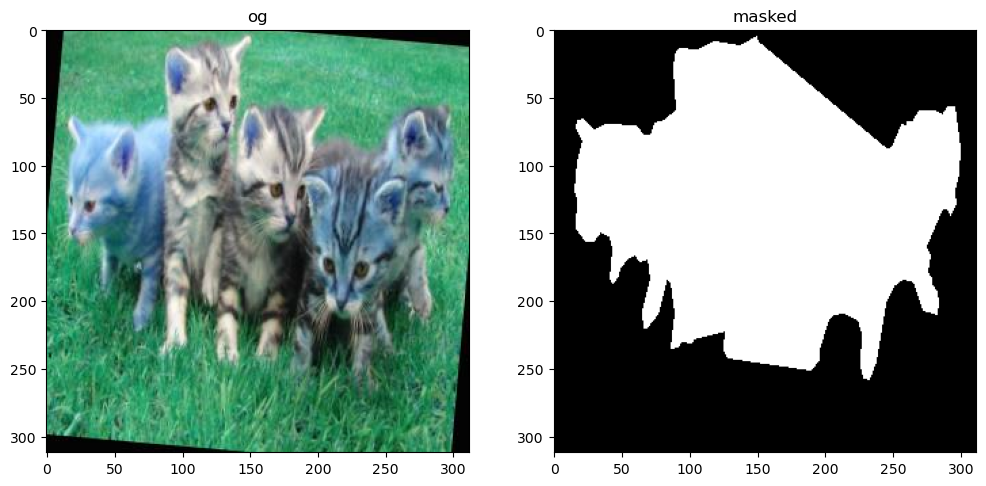

In [54]:
plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
img=cv2.imread(coco_data['images'][0]["file_name"])
plt.imshow(img)
plt.title("og")

plt.subplot(1,2,2)
mask = cv2.imread(r"C:\Users\ujjwa\project\masks\mask_0.png")
print(mask is None)
plt.imshow(mask, cmap='gray')
plt.title("masked")

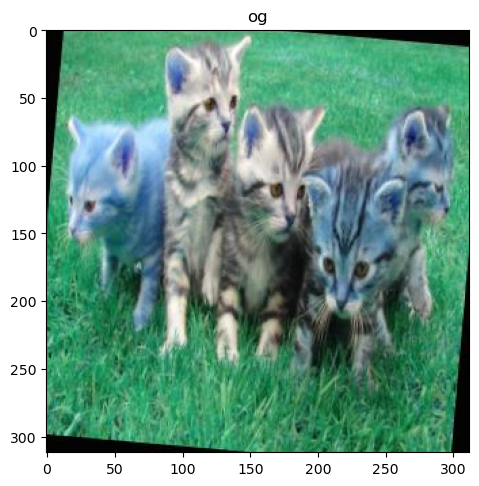

False


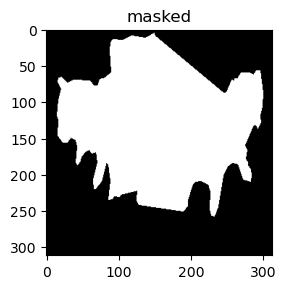

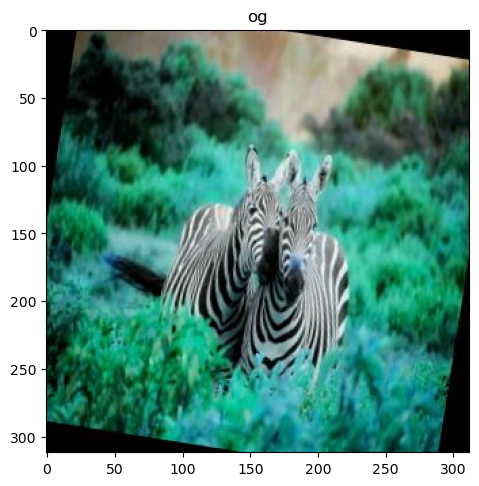

False


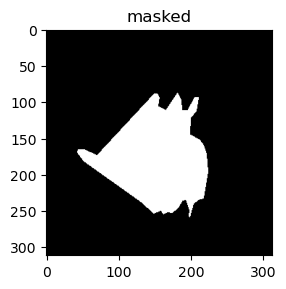

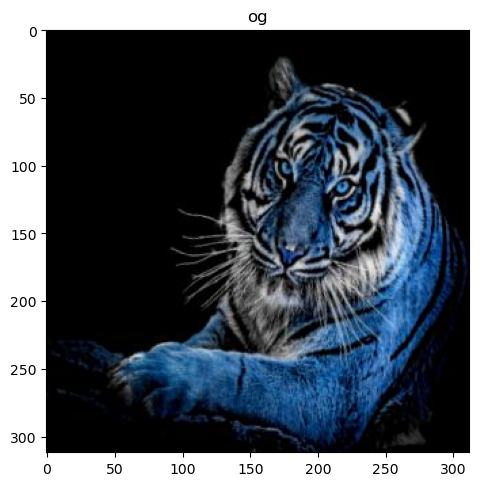

False


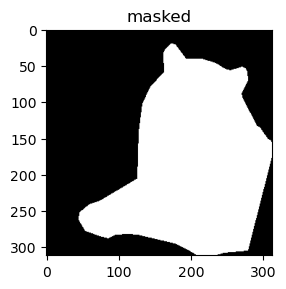

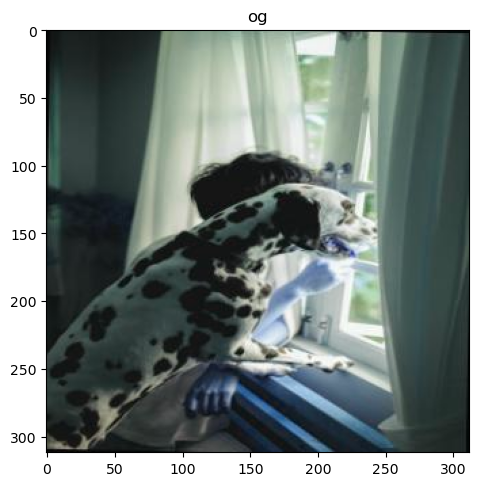

False


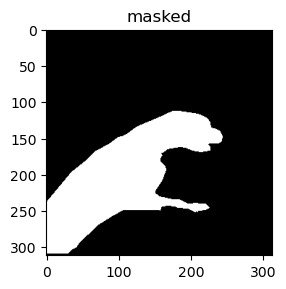

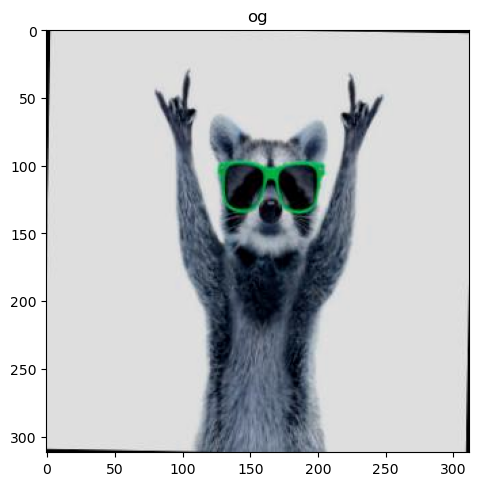

False


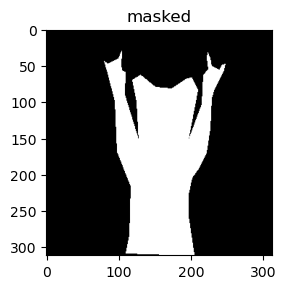

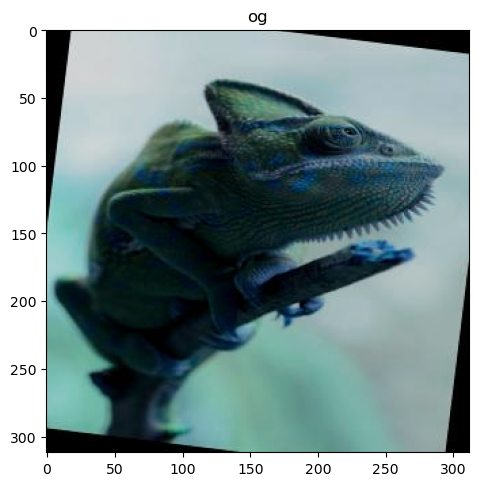

False


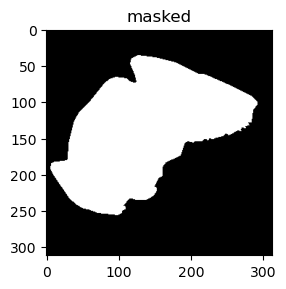

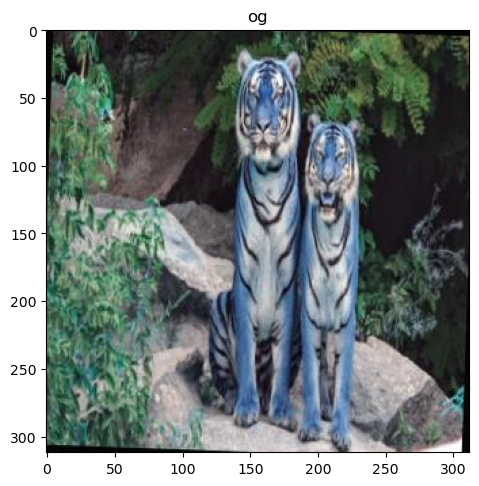

False


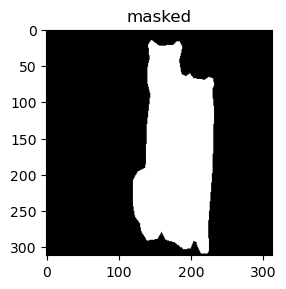

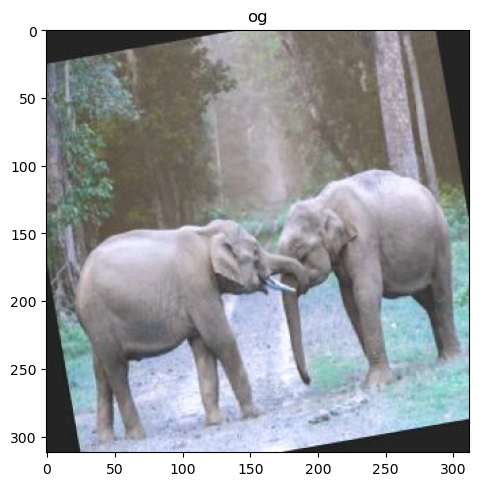

False


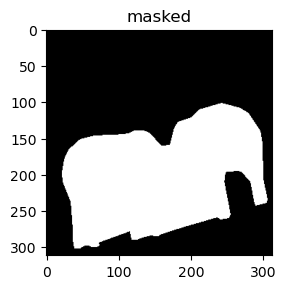

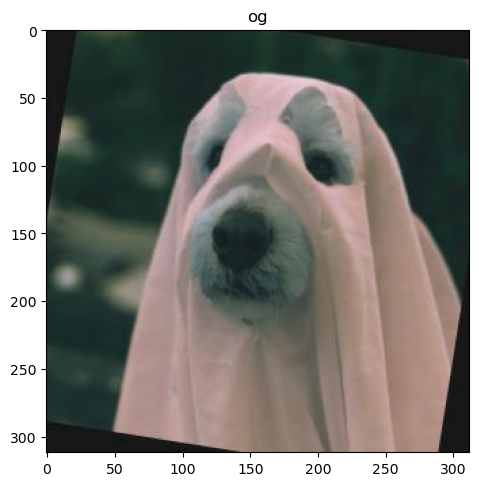

False


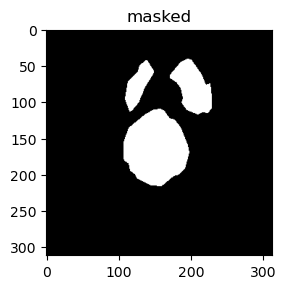

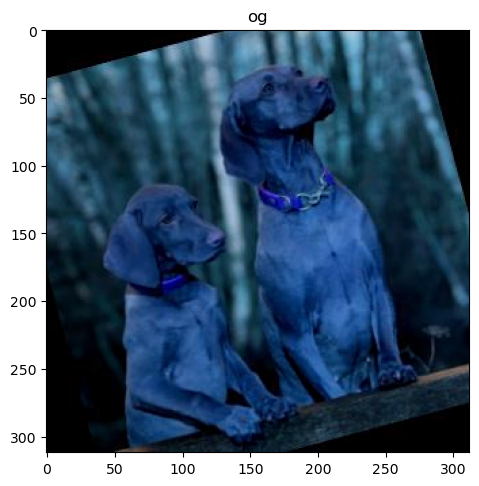

False


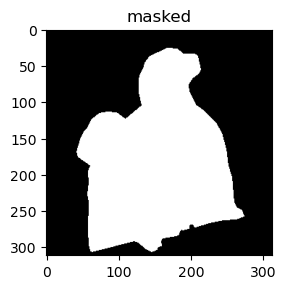

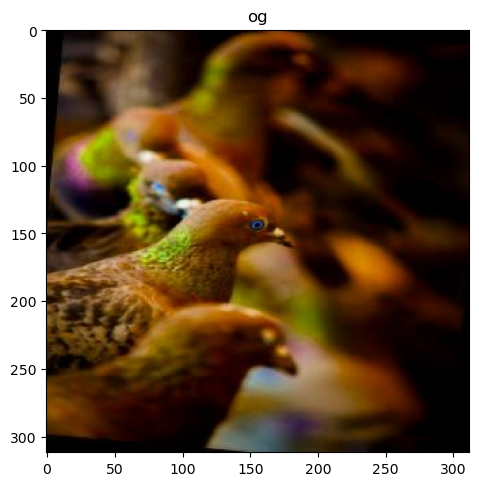

False


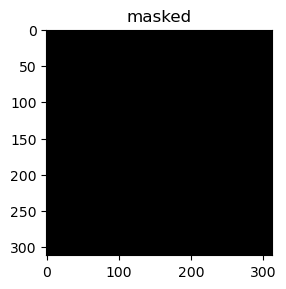

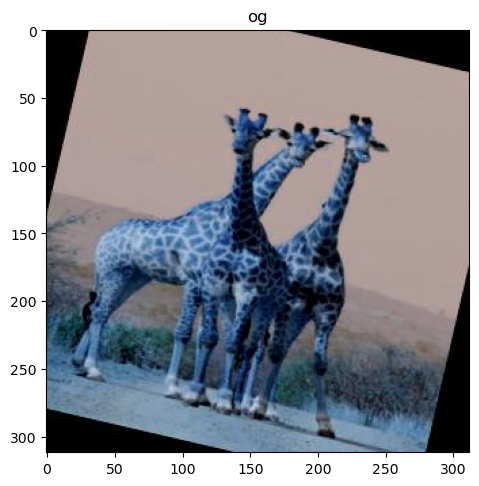

False


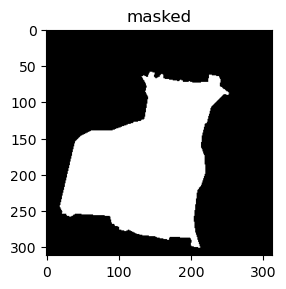

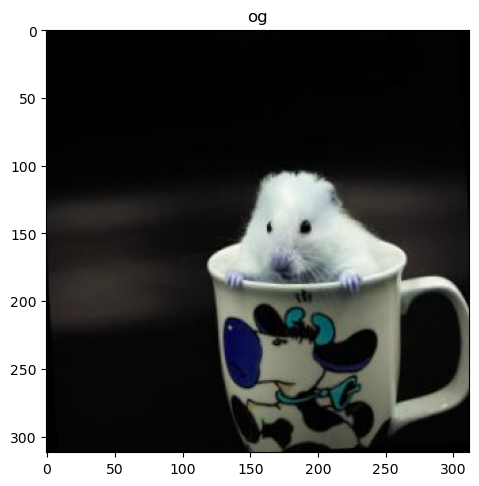

False


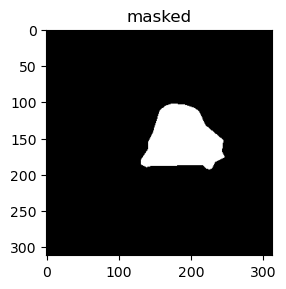

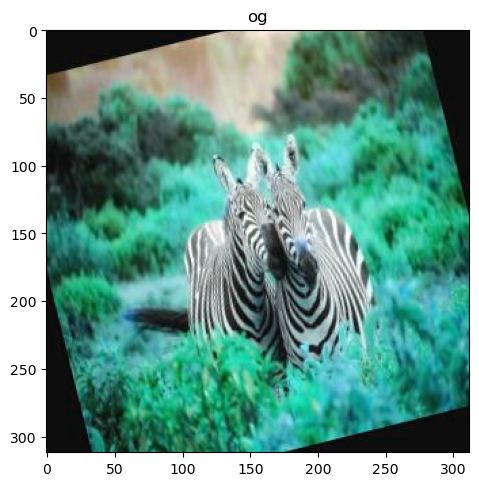

False


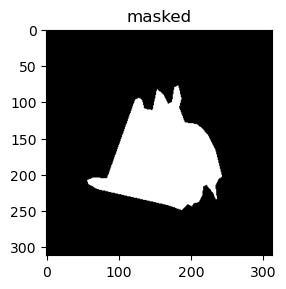

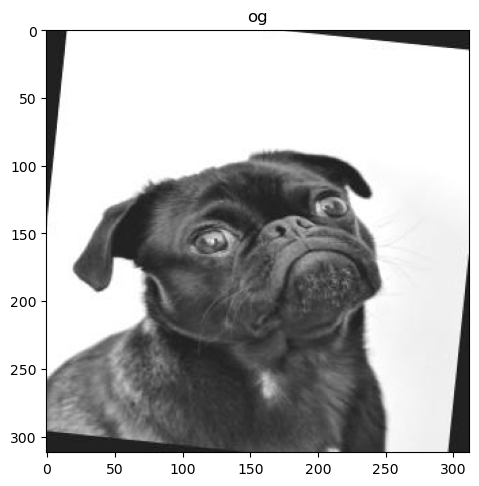

False


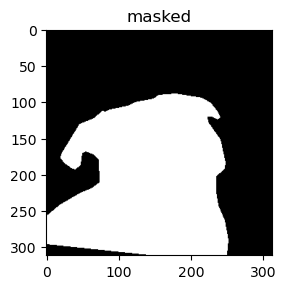

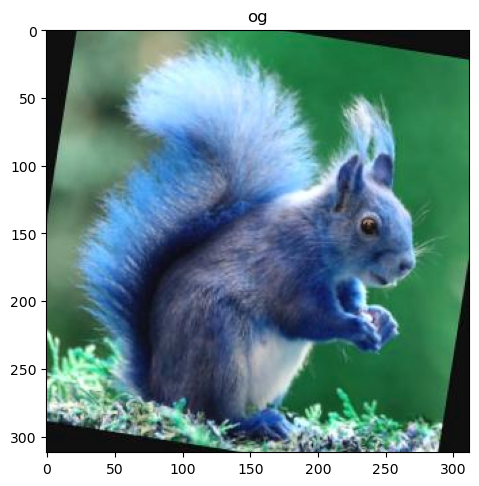

False


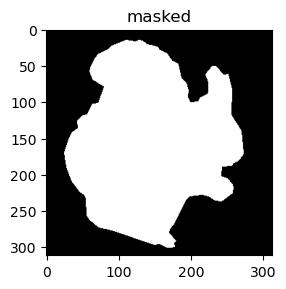

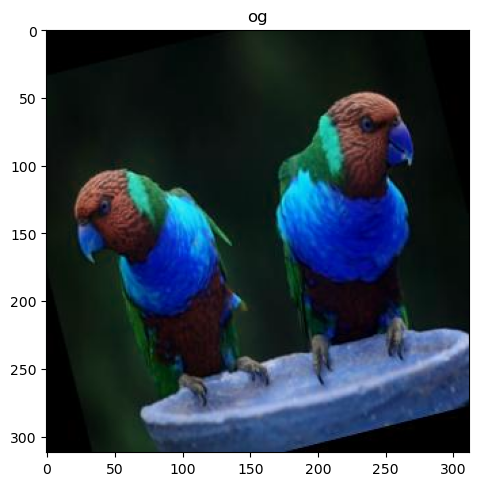

False


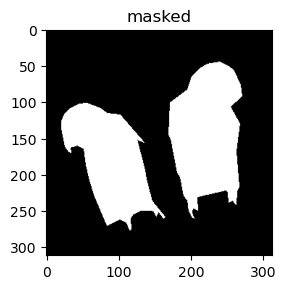

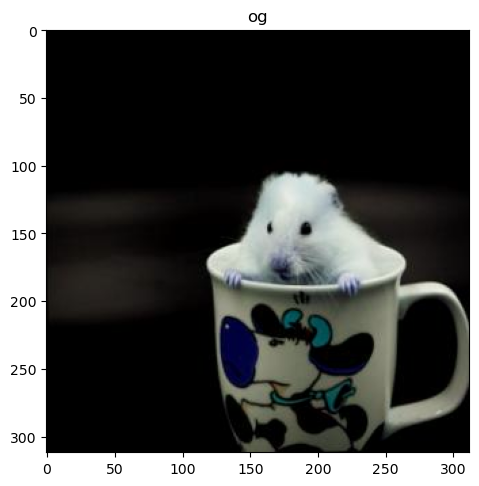

False


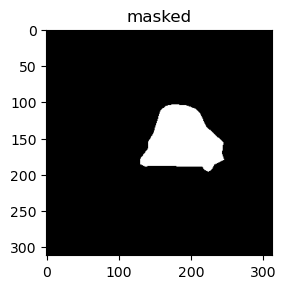

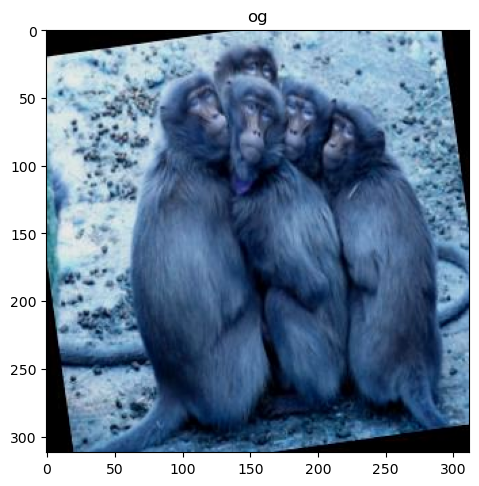

False


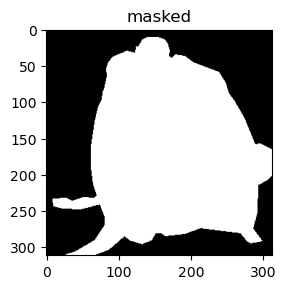

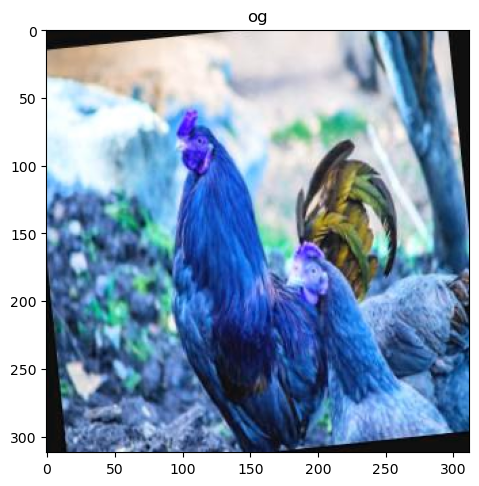

False


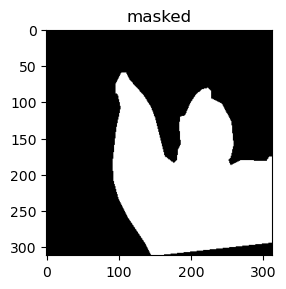

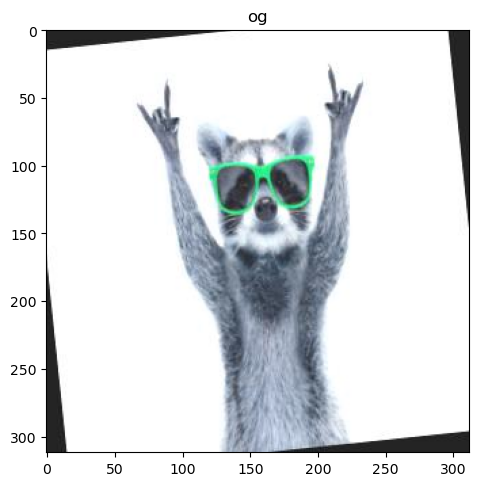

False


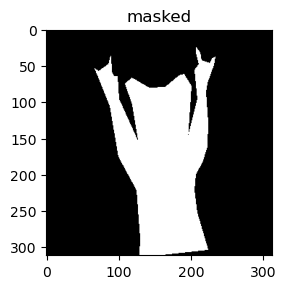

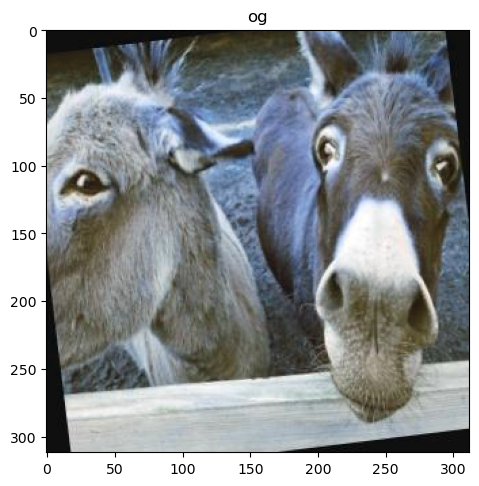

False


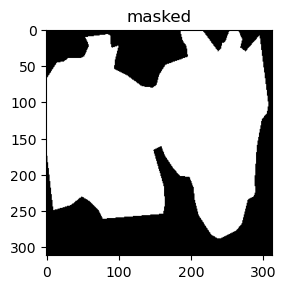

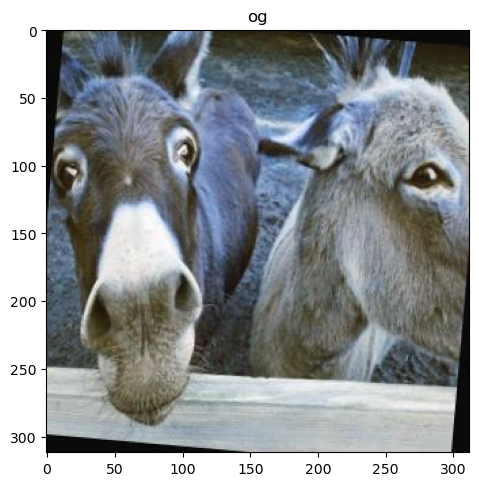

False


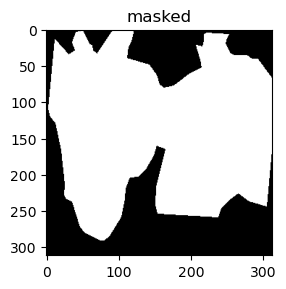

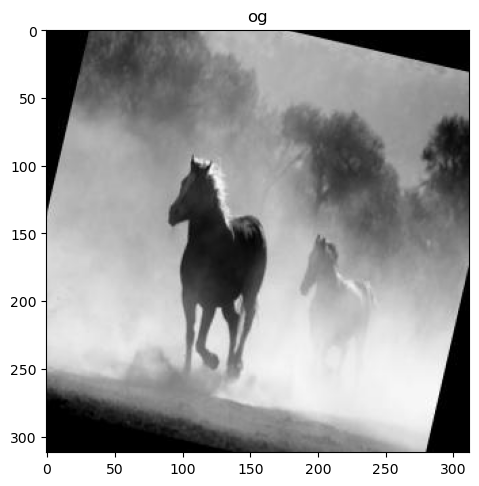

False


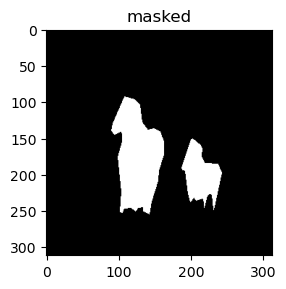

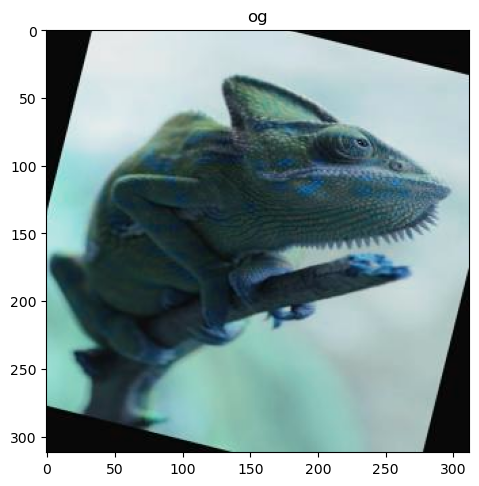

False


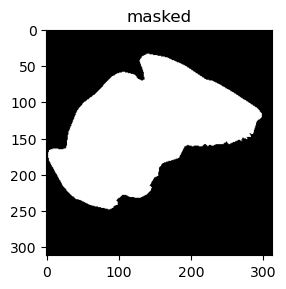

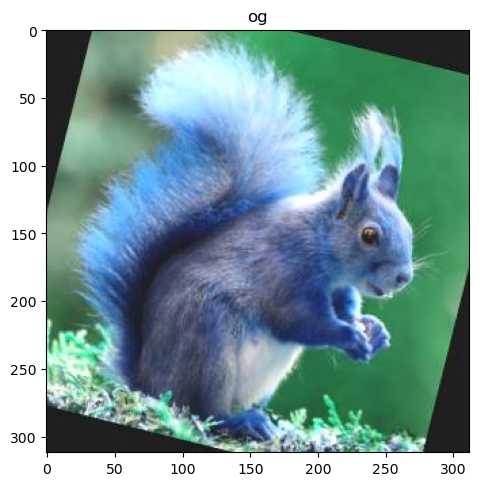

False


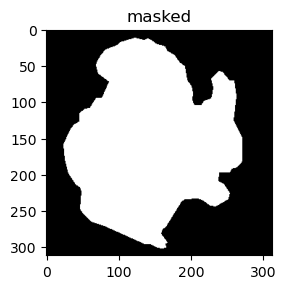

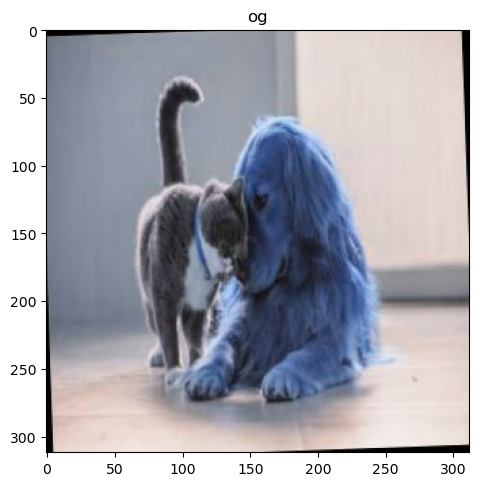

False


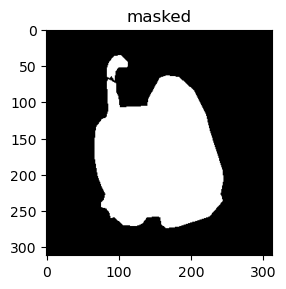

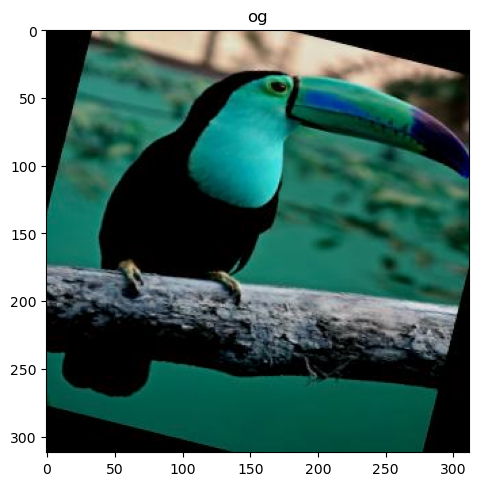

False


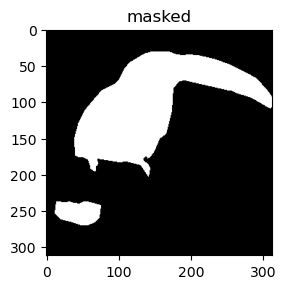

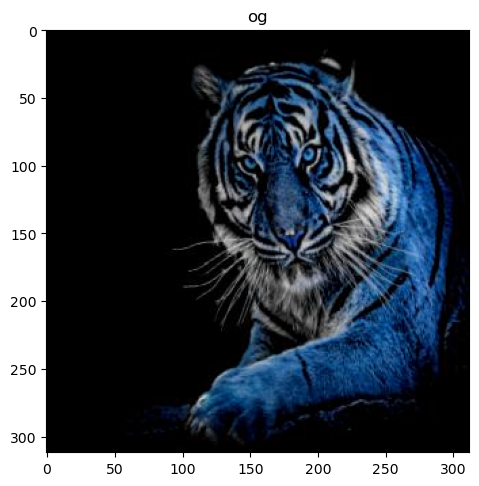

False


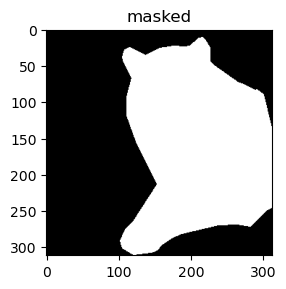

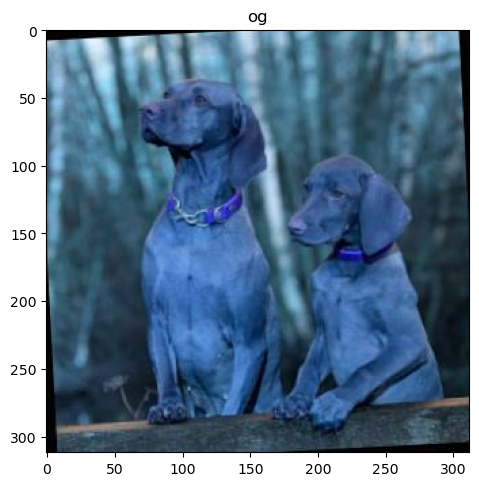

False


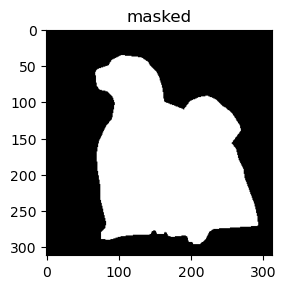

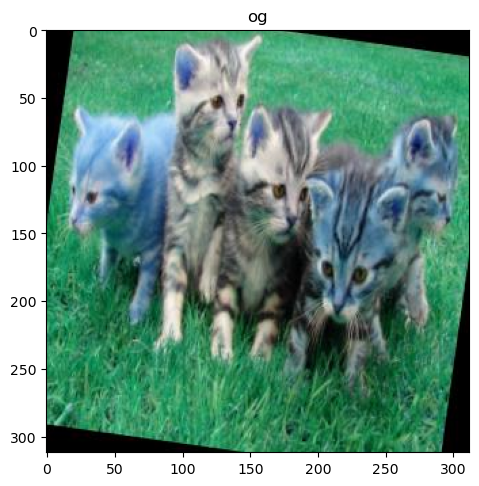

False


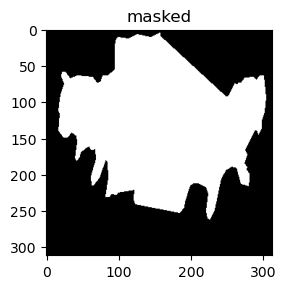

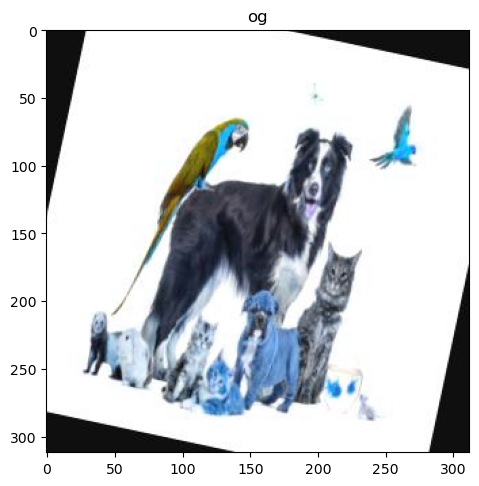

False


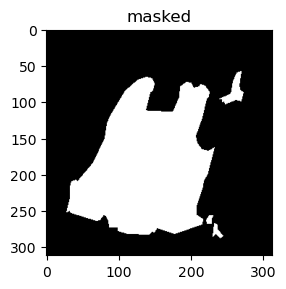

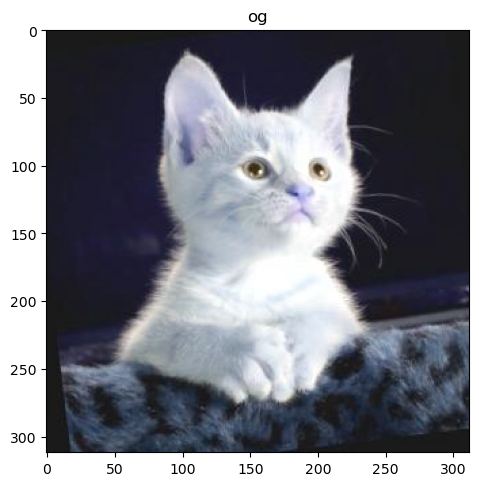

False


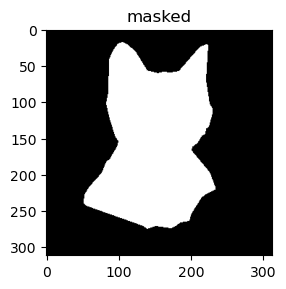

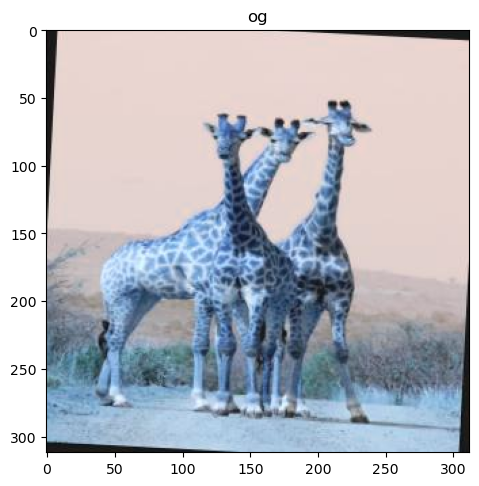

False


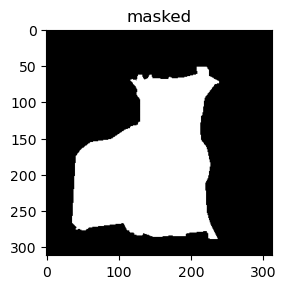

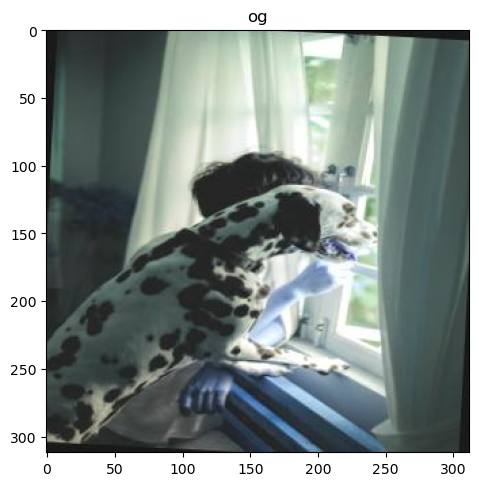

False


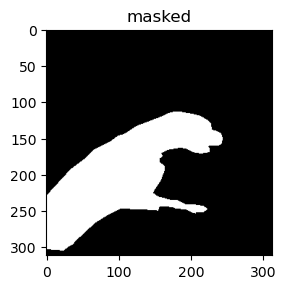

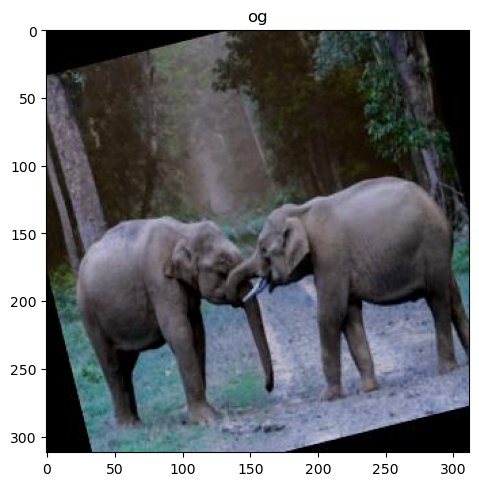

False


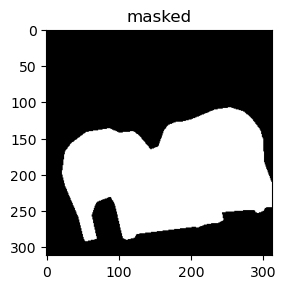

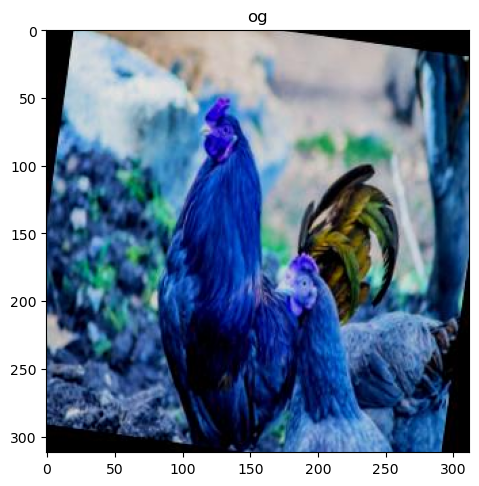

False


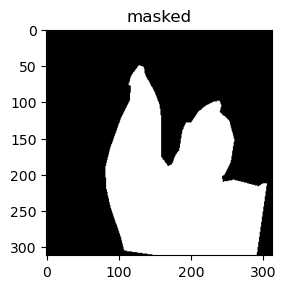

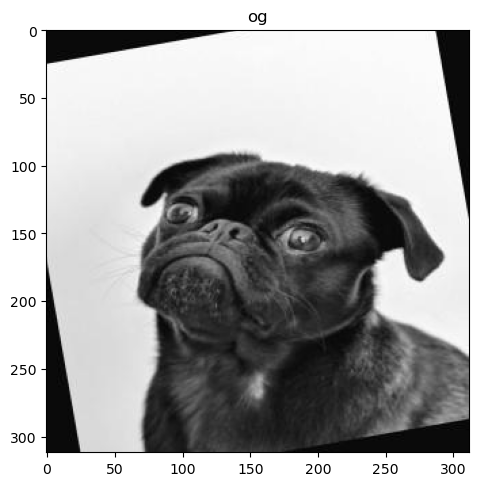

False


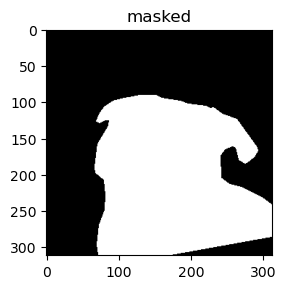

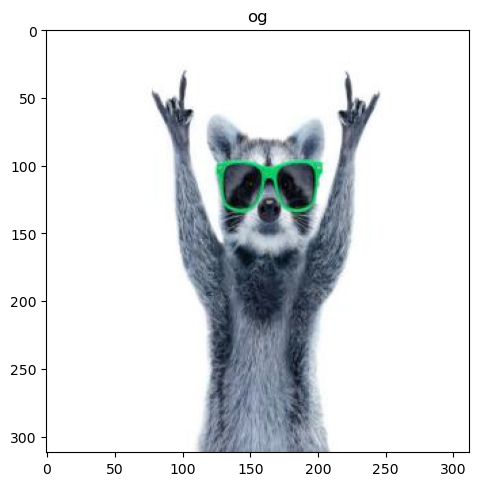

False


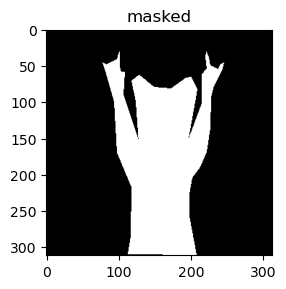

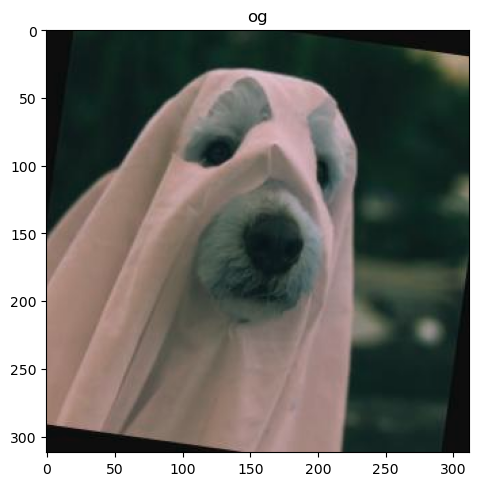

False


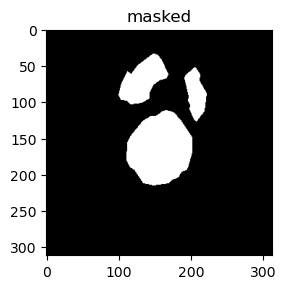

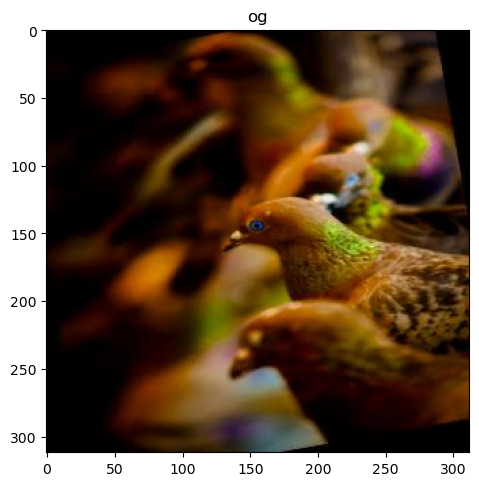

False


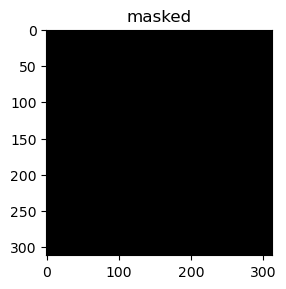

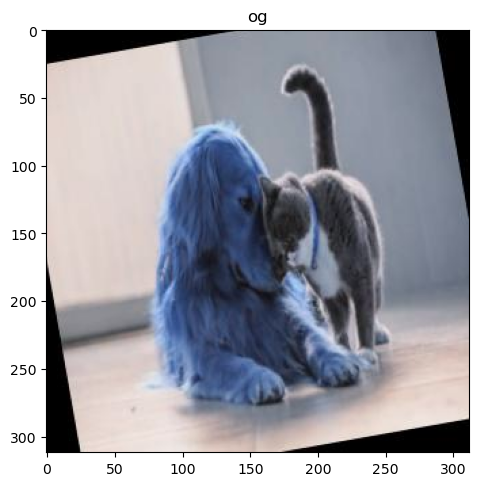

False


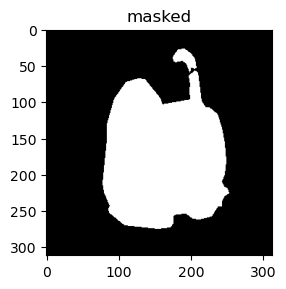

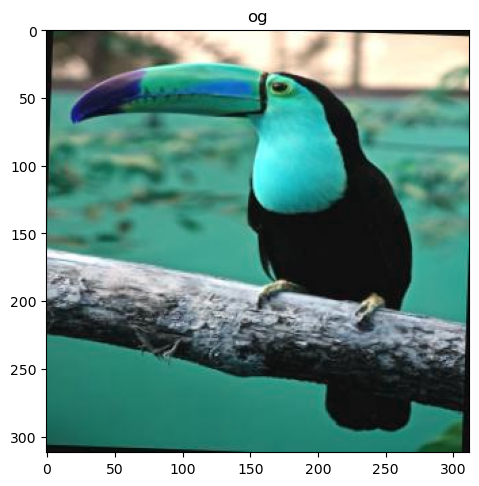

False


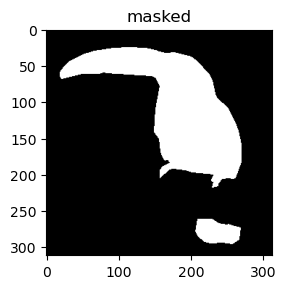

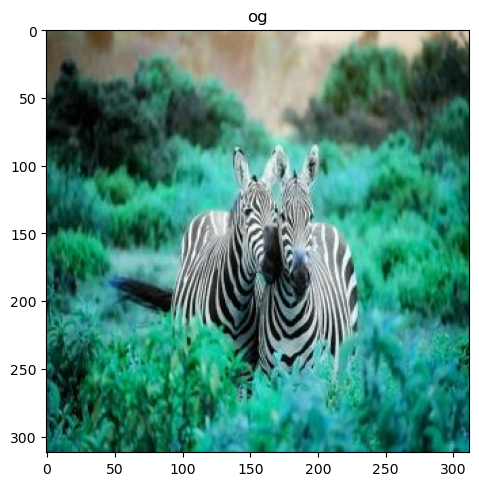

False


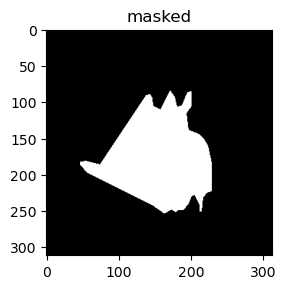

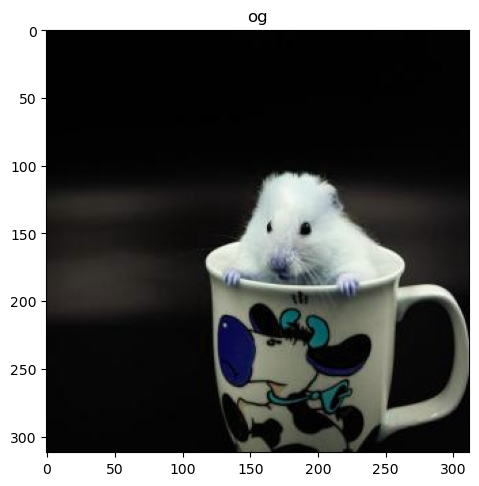

False


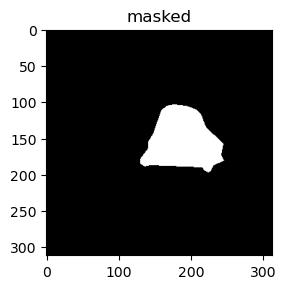

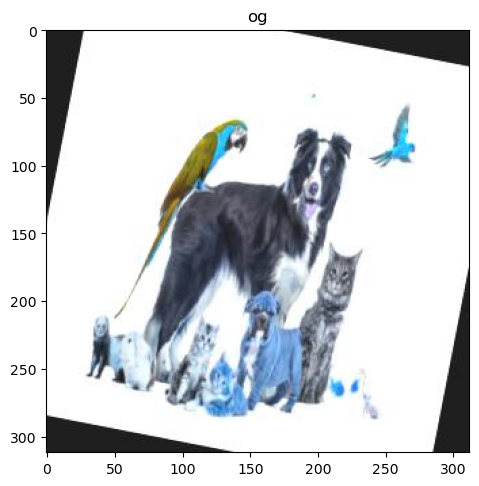

False


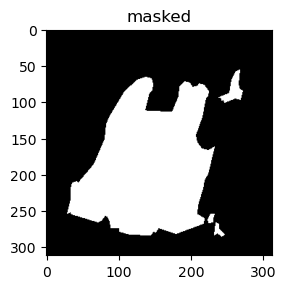

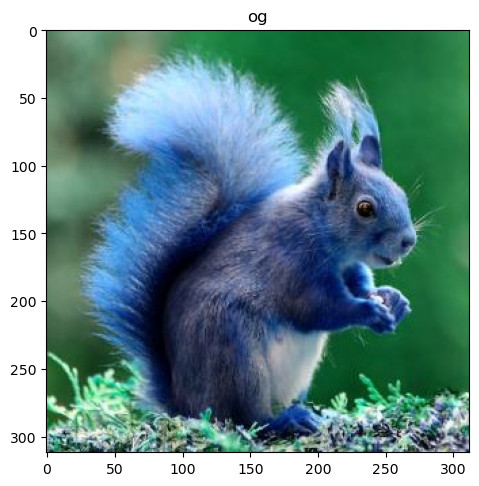

False


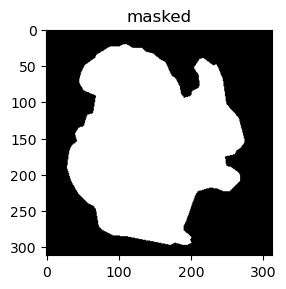

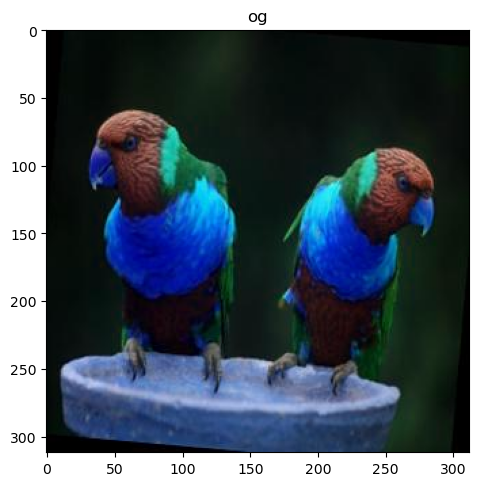

False


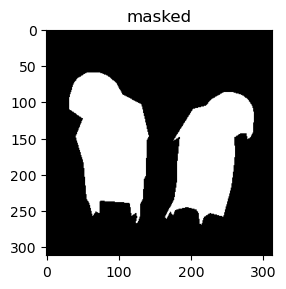

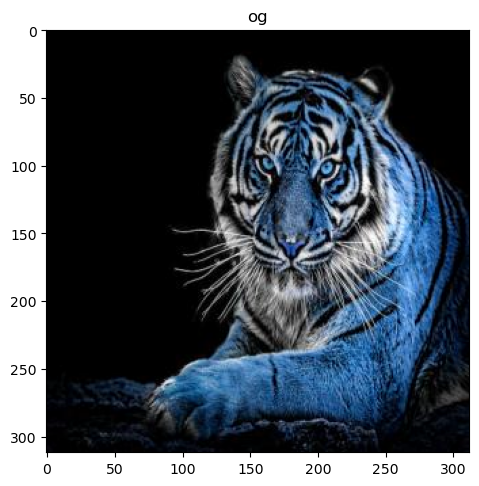

False


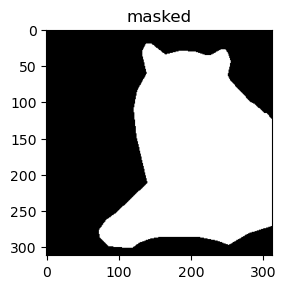

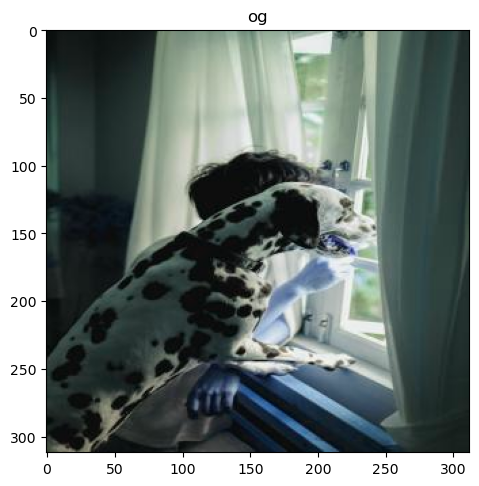

False


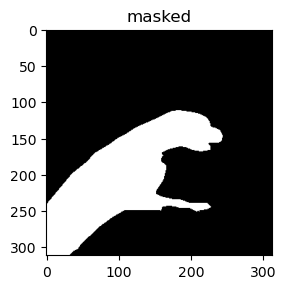

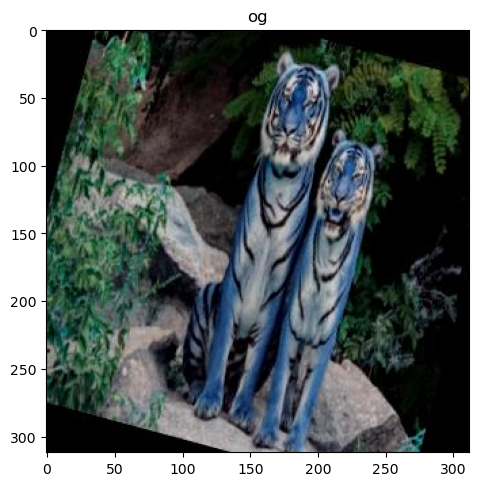

False


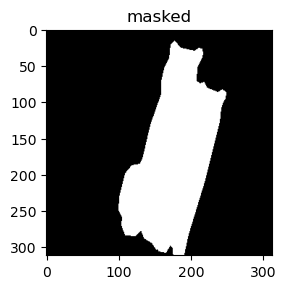

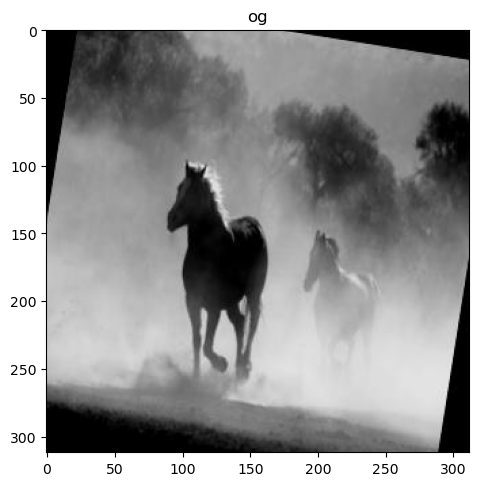

False


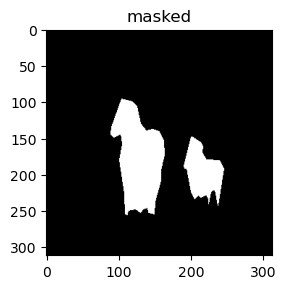

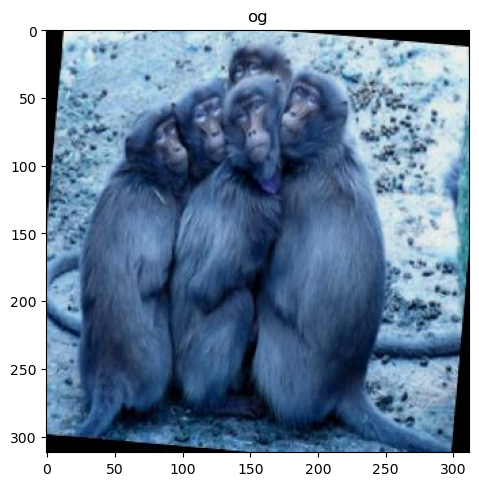

False


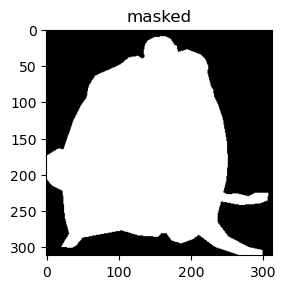

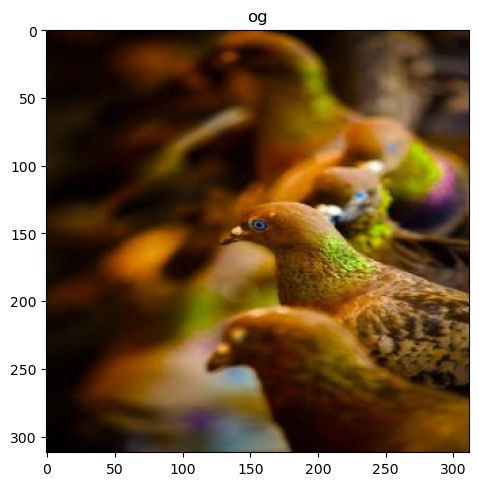

False


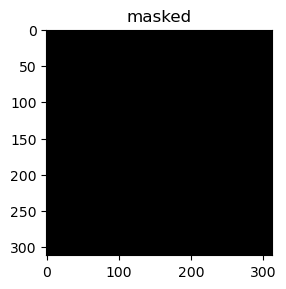

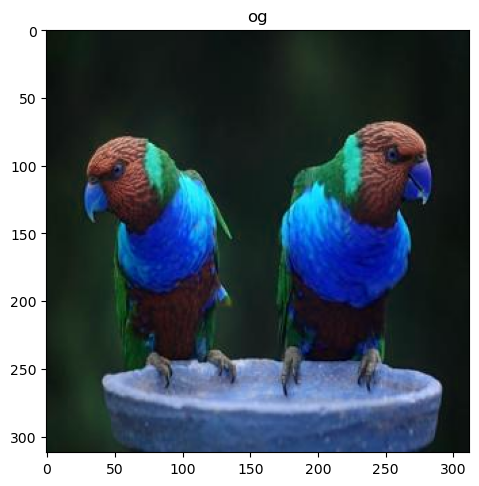

False


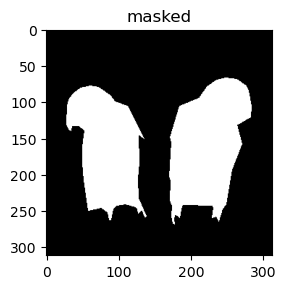

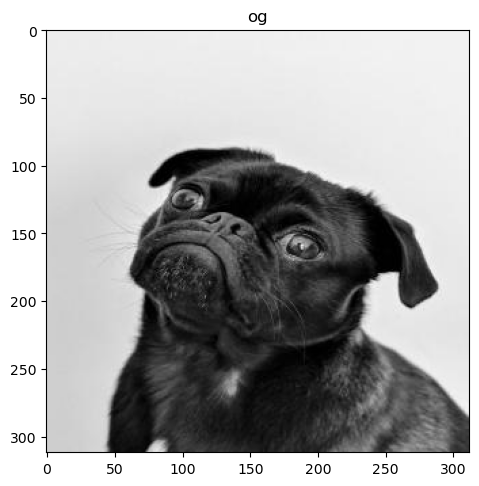

False


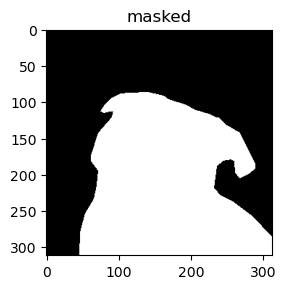

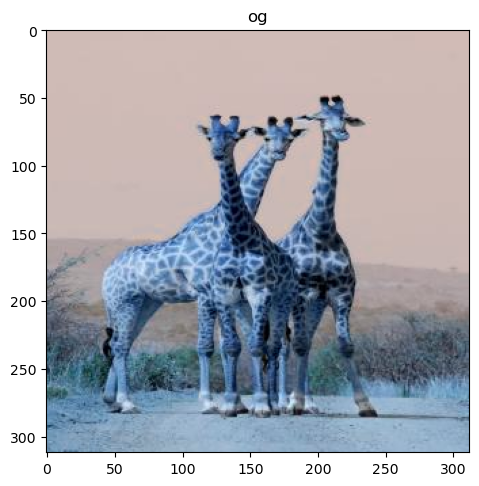

False


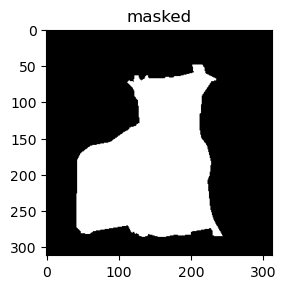

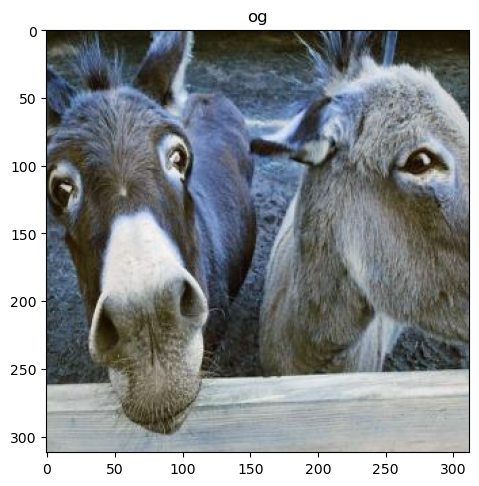

False


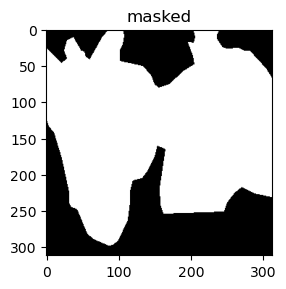

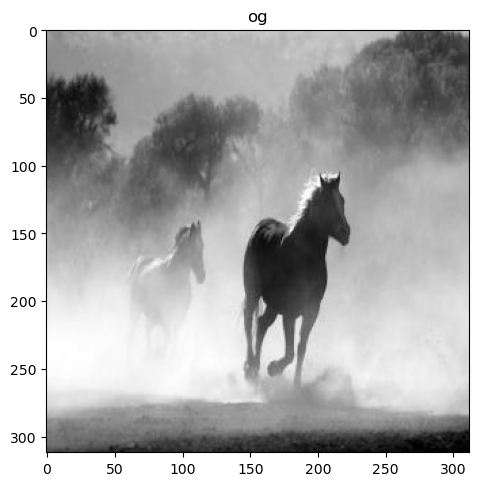

False


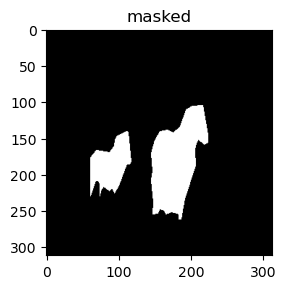

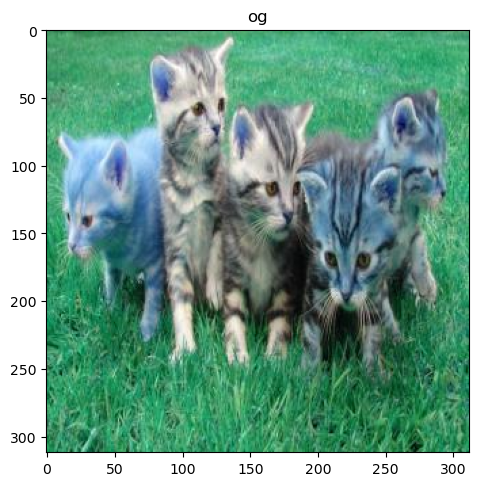

False


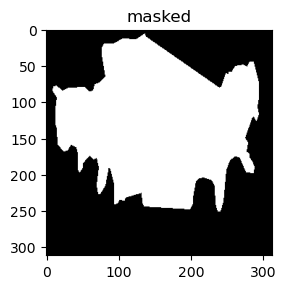

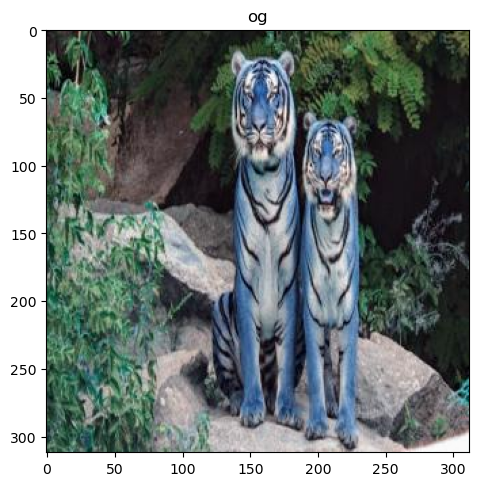

False


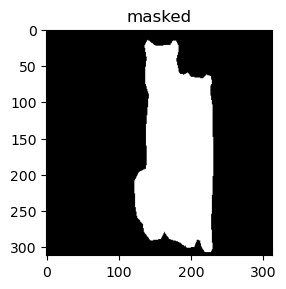

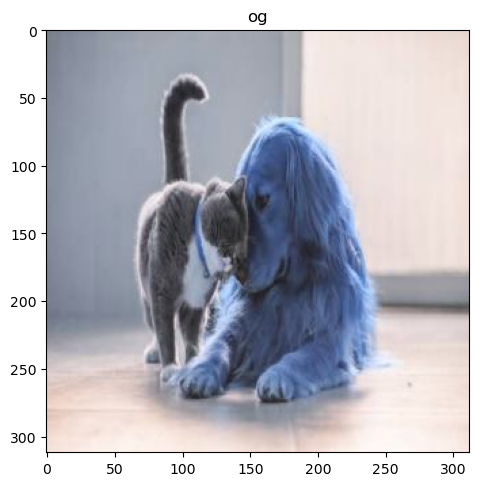

False


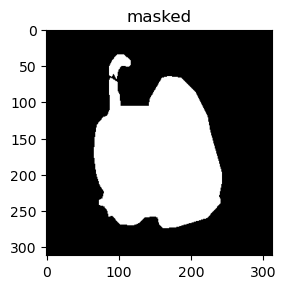

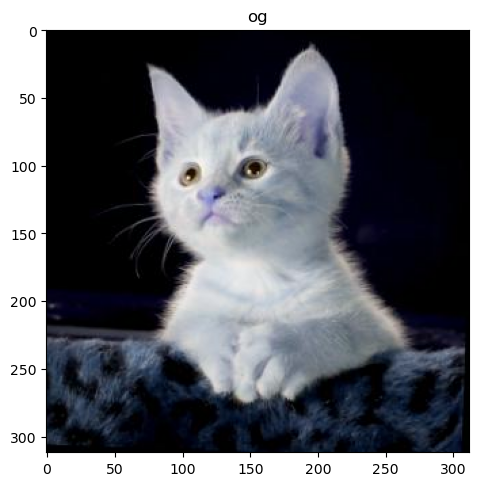

False


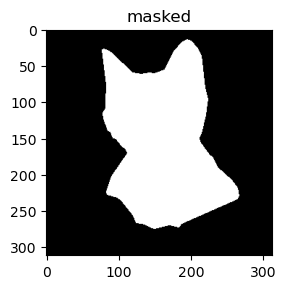

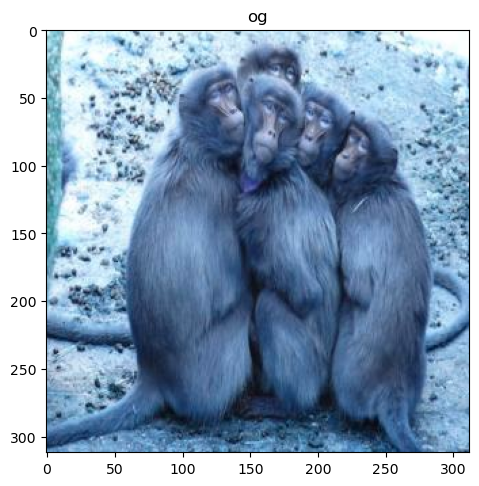

False


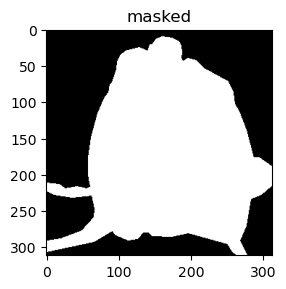

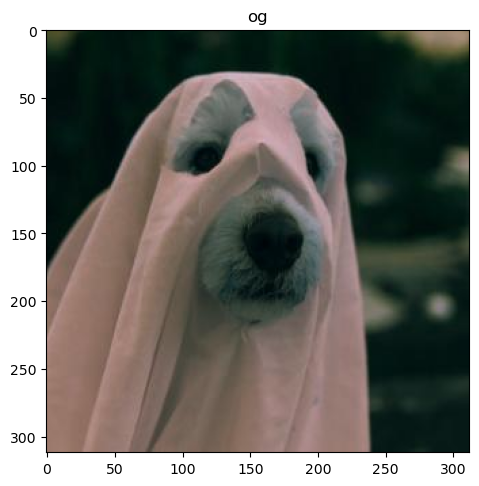

False


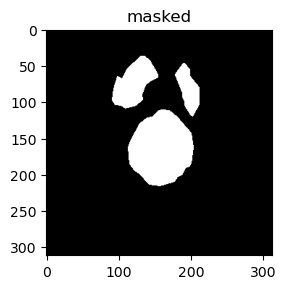

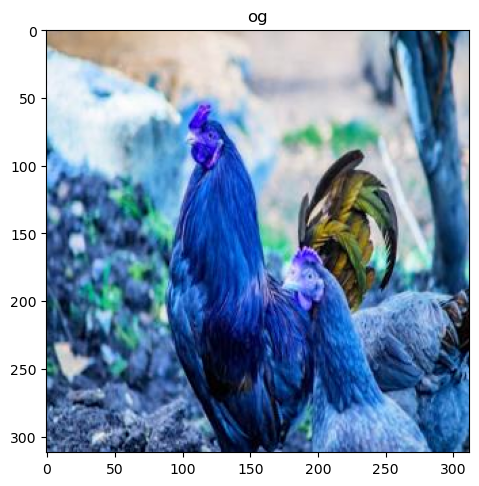

False


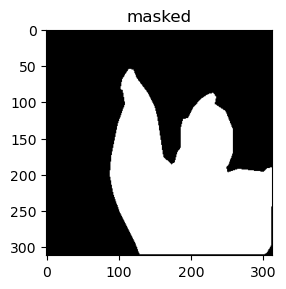

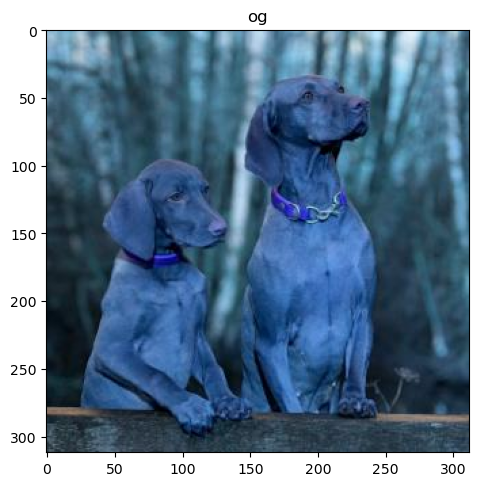

False


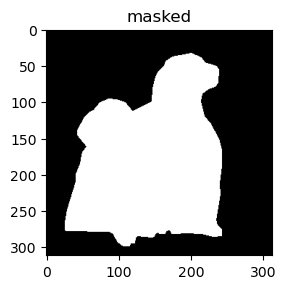

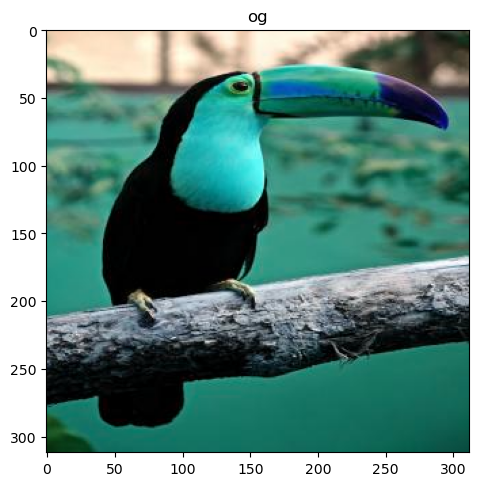

False


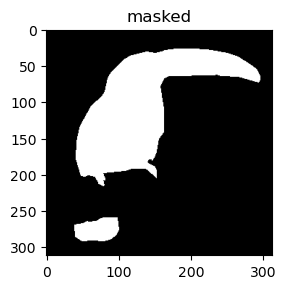

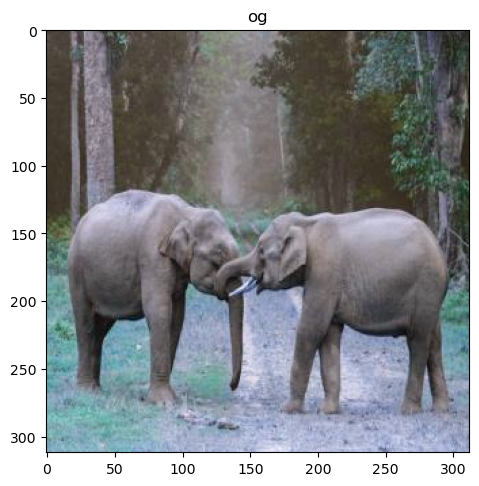

False


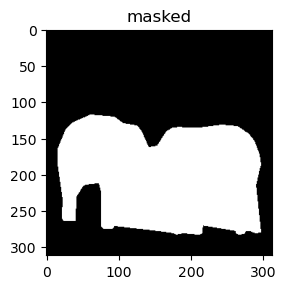

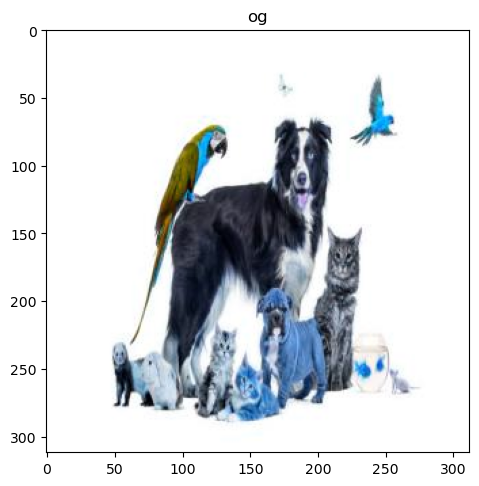

False


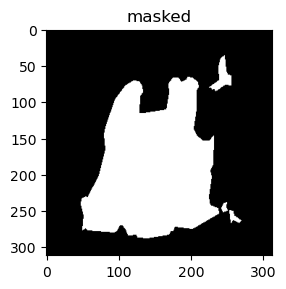

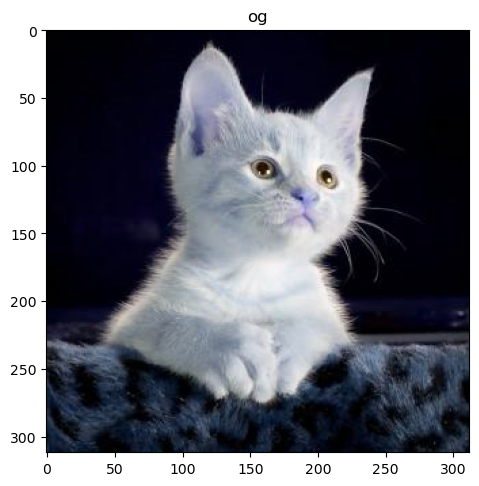

False


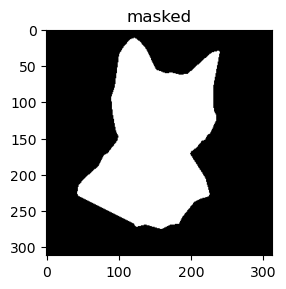

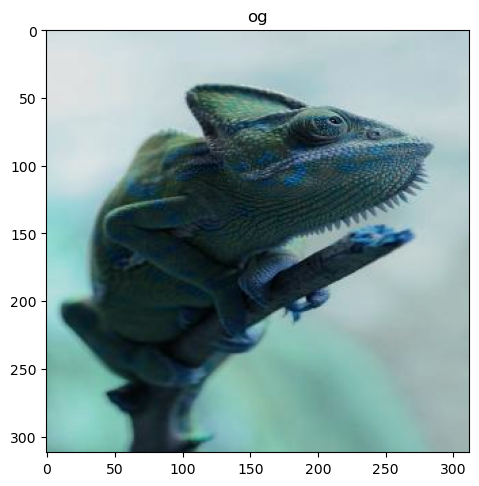

False


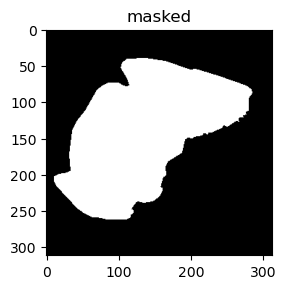

In [56]:
for i in range(72):
    plt.figure(figsize=(12,6))
    plt.subplot(1,2,1)
    img=cv2.imread(coco_data['images'][i]["file_name"])
    plt.imshow(img)
    plt.title("og")
    plt.show()
    
    plt.subplot(1,2,2)
    mask = cv2.imread(rf"C:\Users\ujjwa\project\masks\mask_{i}.png")
    print(mask is None)
    plt.imshow(mask, cmap='gray')
    plt.title("masked")
    plt.show()